PROJET N°7-0 : NETTOYAGE
========================

***Implémentez un modèle de scoring***

**Auteur:** *Jean EMIDIO*

**But**

- Vous êtes Data Scientist au sein d'une société financière, nommée "Prêt à dépenser", qui propose des crédits à la consommation pour des personnes ayant peu ou pas du tout d'historique de prêt.

- L’entreprise souhaite mettre en œuvre un outil de “scoring crédit” pour calculer la probabilité qu’un client rembourse son crédit, puis classifie la demande en crédit accordé ou refusé. Elle souhaite donc développer un algorithme de classification en s’appuyant sur des sources de données variées (données comportementales, données provenant d'autres institutions financières, etc.)

**Mission 1**

- Construire un modèle de scoring qui donnera une prédiction sur la probabilité de faillite d'un client de façon automatique.
- Analyser les features qui contribuent le plus au modèle, d’une manière générale (feature importance globale) et au niveau d’un client (feature importance locale), afin, dans un soucis de transparence, de permettre à un chargé d’études de mieux comprendre le score attribué par le modèle.
- Mettre en production le modèle de scoring de prédiction à l’aide d’une API et réaliser une interface de test de cette API.
- Mettre en œuvre une approche globale MLOps de bout en bout, du tracking des expérimentations à l’analyse en production du data drift.

**Mission 2**

Afin de pouvoir faire évoluer régulièrement le modèle, je souhaite tester la mise en œuvre une démarche de type MLOps d’automatisation et d’industrialisation de la gestion du cycle de vie du modèle. 

Vous trouverez en pièce jointe la liste d’outils à utiliser pour créer une plateforme MLOps qui s’appuie sur des outils Open Source. 

Je souhaite que vous puissiez mettre en oeuvre au minimum les étapes orientées MLOps suivantes : 

- Dans le notebook d’entraînement des modèles, générer à l’aide de MLFlow un tracking d'expérimentations
- Lancer l’interface web 'UI MLFlow" d'affichage des résultats du tracking
- Réaliser avec MLFlow un stockage centralisé des modèles dans un “model registry”
- Tester le serving MLFlow
- Gérer le code avec le logiciel de version Git
- Partager le code sur Github pour assurer une intégration continue
- Utiliser Github Actions pour le déploiement continu et automatisé du code de l’API sur le cloud
- Concevoir des tests unitaires avec Pytest (ou Unittest) et les exécuter de manière automatisée lors du build réalisé par Github Actions
 
J’ai également rassemblé des conseils pour vous aider à vous lancer dans ce projet !

Concernant l’élaboration du modèle soyez vigilant sur deux points spécifiques au contexte métier : 
- Le déséquilibre entre le nombre de bons et de moins bons clients doit être pris en compte pour élaborer un modèle pertinent, avec une méthode au choix
- Le déséquilibre du coût métier entre un faux négatif (FN - mauvais client prédit bon client : donc crédit accordé et perte en capital) et un faux positif (FP - bon client prédit mauvais : donc refus crédit et manque à gagner en marge)
Vous pourrez supposer, par exemple, que le coût d’un FN est dix fois supérieur au coût d’un FP
Vous créerez un score “métier” (minimisation du coût d’erreur de prédiction des FN et FP) pour comparer les modèles, afin de choisir le meilleur modèle et ses meilleurs hyperparamètres. Attention cette minimisation du coût métier doit passer par l’optimisation du seuil qui détermine, à partir d’une probabilité, la classe 0 ou 1 (un “predict” suppose un seuil à 0.5 qui n’est pas forcément l’optimum)
En parallèle, maintenez pour comparaison et contrôle des mesures plus techniques, telles que l’AUC et l’accuracy 

D’autre part je souhaite que vous mettiez en œuvre une démarche d’élaboration des modèles avec Cross-Validation et optimisation des hyperparamètres, via GridsearchCV ou équivalent.

Un dernier conseil : si vous obtenez des scores supérieurs au 1er du challenge Kaggle (AUC > 0.82), posez-vous la question si vous n’avez pas de l’overfitting dans votre modèle !

Vous exposerez votre modèle de prédiction sous forme d’une API qui permet de calculer la probabilité de défaut du client, ainsi que sa classe (accepté ou refusé) en fonction du seuil optimisé d’un point de vue métier.

Le déploiement de l’API sera réalisée sur une plateforme Cloud, de préférence une solution gratuite.

Je vous propose d’utiliser un Notebook ou une application Streamlit pour réaliser en local  l’interface de test de l’API.

**Outils Open Source pour élaborer une plateforme MLOps**

- MLFlow pour la gestion “d’expériences” et leur tracking lors de la phase d’entraînement des modèles, ainsi que la visualisation des résultats avec MLFlow UI
- MLFlow pour le stockage centralisé des modèles dans un “model registry” et le serving
- Git, logiciel de version de code, pour suivre les modifications du code final de l’API de prédiction à déployer
- Github pour stocker et partager sur le cloud le code de l’API, alimenté par un “push” Git et ainsi assurer une intégration continue
- Github Actions pour le déploiement continu et automatisé du code de l’API sur le cloud
- Pytest (ou Unittest) pour concevoir les tests unitaires et les exécuter de manière automatisée lors du build réalisé par Github

**Objectifs pédagogiques**

- Définir et mettre en œuvre un pipeline d’entraînement des modèles
- Définir la stratégie d’élaboration d’un modèle d’apprentissage supervisé
- Évaluer les performances des modèles d’apprentissage supervisé
- Mettre en œuvre un logiciel de version de code
- Suivre la performance d’un modèle en production et en assurer la maintenance
- Concevoir un déploiement continu d'un moteur d’inférence sur une plateforme Cloud

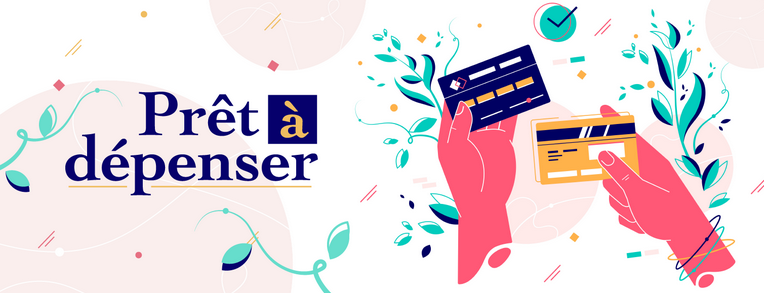

**Table of contents**<a id='toc0_'></a>    
- [Les datas](#toc1_)    
  - [Import](#toc1_1_)    
  - [Initialisations](#toc1_2_)    
  - [Fonctions](#toc1_3_)    
  - [Dataset](#toc1_4_)    
- [Liste des fichiers de data](#toc2_)    
- [Préparation des données et feature engineering](#toc3_)    
- [Traitement des données](#toc4_)    
- [Réduction de features](#toc5_)    
- [Etude de la corrélation entre Target/Features](#toc6_)    
- [Sauvegarde](#toc7_)    
- [Exportation](#toc8_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# <a id='toc1_'></a>[Les datas](#toc0_)

## <a id='toc1_1_'></a>[Import](#toc0_)

In [105]:
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [106]:
import joblib

In [107]:
import time
import gc
import re
import os

In [108]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import VarianceThreshold
from contextlib import contextmanager

## <a id='toc1_2_'></a>[Initialisations](#toc0_)

In [109]:
# Initialisations :
SEED = 15 # Ici on définit RANDOM_SEED = constant seulement pour la reproductibilité
warnings.filterwarnings('ignore')

# Paramètres d'affichage :
pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)
pd.set_option("display.max_colwidth", None)

# Formats :
sns.set_style("whitegrid")
font_title = {
  "family": "serif",
  "color":  "black",
  "weight": "bold",
  "size": 20
}

## <a id='toc1_3_'></a>[Fonctions](#toc0_)

In [110]:
import fonctions_python as fc
import importlib
importlib.reload(fc)

<module 'fonctions_python' from 'c:\\Users\\jme1401\\Desktop\\OCR\\7-Implémentez un modèle de scoring\\Datas\\fonctions_python.py'>

In [111]:
@contextmanager
def fc_timer(title):
    '''Fonction calculant le temps d'éxécution d'autres fonctions.
    Keyword arguments:
    title -- titre de la fonction exécutée.
    '''

    t0 = time.time()
    yield
    print(f"{title} - réalisé en {time.time() - t0:.0f}s")


def fc_one_hot_encoder(df, nan_as_category = True):
    '''Encodage des variables catégorielles.
    Keyword arguments:
    df -- dataframe
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    df -- dataframe encodé
    new_columns -- nouvelles colonnes créées par l'encodage.
    '''

    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns = categorical_columns, dummy_na = nan_as_category, dtype = int)
    new_columns = [c for c in df.columns if c not in original_columns]
    
    return df, new_columns


def fc_application_train_test(path_datas, num_rows = None, nan_as_category = False):
    '''Preprocessing de application_train.csv et application_test.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default False)
    Returns:
    df_datas -- dataframe mergé et preprocessing réalisé.
    '''

    # Read data and merge
    df_train = pd.read_csv(path_datas + 'application_train.csv', nrows = num_rows)
    df_test = pd.read_csv(path_datas + 'application_test.csv', nrows = num_rows)
    print("Taille des données d'entrainement: {}, Taille des données de test: {}".format(len(df_train), len(df_test)))
    
    df_datas = pd.concat([df_train, df_test], ignore_index = True)

    # Optional: Remove 4 applications with XNA CODE_GENDER (train set)
    df_datas = df_datas[df_datas['CODE_GENDER'] != 'XNA']
    
    # Categorical features with Binary encode (0 or 1; two categories)
    for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
        df_datas[bin_feature], uniques = pd.factorize(df_datas[bin_feature])
    
    # Categorical features with One-Hot encode
    df_datas, cat_datas = fc_one_hot_encoder(df_datas, nan_as_category)
    
    # NaN values for DAYS_EMPLOYED: 365.243 -> nan
    df_datas['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)

    # Some simple new features (percentages)
    df_datas['DAYS_EMPLOYED_PERC'] = df_datas['DAYS_EMPLOYED'] / df_datas['DAYS_BIRTH']
    df_datas['INCOME_CREDIT_PERC'] = df_datas['AMT_INCOME_TOTAL'] / df_datas['AMT_CREDIT']
    df_datas['INCOME_PER_PERSON'] = df_datas['AMT_INCOME_TOTAL'] / df_datas['CNT_FAM_MEMBERS']
    df_datas['ANNUITY_INCOME_PERC'] = df_datas['AMT_ANNUITY'] / df_datas['AMT_INCOME_TOTAL']
    df_datas['PAYMENT_RATE'] = df_datas['AMT_ANNUITY'] / df_datas['AMT_CREDIT']

    del df_test
    gc.collect()
    
    return df_datas


def fc_bureau_and_balance(path_datas, num_rows = None, nan_as_category = True):
    '''Preprocessing de bureau.csv et bureau_balance.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    df_bureau_agg -- dataframe aggregé et preprocessing réalisé.
    '''

    df_bureau = pd.read_csv(path_datas + 'bureau.csv', nrows = num_rows)
    df_bureau_balance = pd.read_csv(path_datas + 'bureau_balance.csv', nrows = num_rows)

    df_bureau, cat_bureau = fc_one_hot_encoder(df_bureau, nan_as_category)
    df_bureau_balance, cat_bureau_balance = fc_one_hot_encoder(df_bureau_balance, nan_as_category)
    
    # Bureau balance: Perform aggregations and merge with bureau.csv
    df_bureau_balance_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}

    for col in cat_bureau_balance:
        df_bureau_balance_aggregations[col] = ['mean']

    df_bureau_balance_agg = df_bureau_balance.groupby('SK_ID_BUREAU').agg(df_bureau_balance_aggregations)
    df_bureau_balance_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in df_bureau_balance_agg.columns.tolist()])
    df_bureau = df_bureau.join(df_bureau_balance_agg, how = 'left', on = 'SK_ID_BUREAU')
    df_bureau.drop(['SK_ID_BUREAU'], axis = 1, inplace = True)
    del df_bureau_balance, df_bureau_balance_agg
    gc.collect()
    
    # Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }

    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in cat_bureau: cat_aggregations[cat] = ['mean']
    for cat in cat_bureau_balance: cat_aggregations[cat + "_MEAN"] = ['mean']
    
    df_bureau_agg = df_bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    df_bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in df_bureau_agg.columns.tolist()])
    
    # Bureau: Active credits - using only numerical aggregations
    df_active = df_bureau[df_bureau['CREDIT_ACTIVE_Active'] == 1]
    df_active_agg = df_active.groupby('SK_ID_CURR').agg(num_aggregations)
    df_active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in df_active_agg.columns.tolist()])
    df_bureau_agg = df_bureau_agg.join(df_active_agg, how = 'left', on = 'SK_ID_CURR')
    del df_active, df_active_agg
    gc.collect()
    
    # Bureau: Closed credits - using only numerical aggregations
    df_closed = df_bureau[df_bureau['CREDIT_ACTIVE_Closed'] == 1]
    df_closed_agg = df_closed.groupby('SK_ID_CURR').agg(num_aggregations)
    df_closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in df_closed_agg.columns.tolist()])
    df_bureau_agg = df_bureau_agg.join(df_closed_agg, how = 'left', on = 'SK_ID_CURR')
    del df_closed, df_closed_agg, df_bureau
    gc.collect()
    
    return df_bureau_agg


def fc_credit_card_balance(path_datas, num_rows = None, nan_as_category = True):
    '''Preprocessing de credit_card_balance.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    df_credit_card_balance_agg -- dataframe aggregé et preprocessing réalisé.
    '''

    df_credit_card_balance = pd.read_csv(path_datas + 'credit_card_balance.csv', nrows = num_rows)
    df_credit_card_balance, cat_credit_card_balance = fc_one_hot_encoder(df_credit_card_balance, nan_as_category = True)
    
    # General aggregations
    df_credit_card_balance.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    df_credit_card_balance_agg = df_credit_card_balance.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    df_credit_card_balance_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in df_credit_card_balance_agg.columns.tolist()])
    
    # Count credit card lines
    df_credit_card_balance_agg['CC_COUNT'] = df_credit_card_balance.groupby('SK_ID_CURR').size()
    del df_credit_card_balance
    gc.collect()
    
    return df_credit_card_balance_agg
    

def fc_installments_payments(path_datas, num_rows = None, nan_as_category = True):
    '''Preprocessing de installments_payments.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    df_installments_payments_agg -- dataframe aggregé et preprocessing réalisé.
    '''

    df_installments_payments = pd.read_csv(path_datas + 'installments_payments.csv', nrows = num_rows)
    df_installments_payments, cat_installments_payments = fc_one_hot_encoder(df_installments_payments, nan_as_category = True)
    
    # Percentage and difference paid in each installment (amount paid and installment value)
    df_installments_payments['PAYMENT_PERC'] = df_installments_payments['AMT_PAYMENT'] / df_installments_payments['AMT_INSTALMENT']
    df_installments_payments['PAYMENT_DIFF'] = df_installments_payments['AMT_INSTALMENT'] - df_installments_payments['AMT_PAYMENT']

    # Days past due and days before due (no negative values)
    df_installments_payments['DPD'] = df_installments_payments['DAYS_ENTRY_PAYMENT'] - df_installments_payments['DAYS_INSTALMENT']
    df_installments_payments['DBD'] = df_installments_payments['DAYS_INSTALMENT'] - df_installments_payments['DAYS_ENTRY_PAYMENT']
    df_installments_payments['DPD'] = df_installments_payments['DPD'].apply(lambda x: x if x > 0 else 0)
    df_installments_payments['DBD'] = df_installments_payments['DBD'].apply(lambda x: x if x > 0 else 0)
    
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum', 'var'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    
    for cat in cat_installments_payments:
        aggregations[cat] = ['mean']

    df_installments_payments_agg = df_installments_payments.groupby('SK_ID_CURR').agg(aggregations)
    df_installments_payments_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in df_installments_payments_agg.columns.tolist()])

    # Count installments accounts
    df_installments_payments_agg['INSTAL_COUNT'] = df_installments_payments.groupby('SK_ID_CURR').size()
    del df_installments_payments
    gc.collect()
    
    return df_installments_payments_agg


def fc_pos_cash_balance(path_datas, num_rows = None, nan_as_category = True):
    '''Preprocessing de POS_CASH_balance.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    df_pos_cash_balance_agg -- dataframe aggregé et preprocessing réalisé.
    '''

    df_pos_cash_balance = pd.read_csv(path_datas + 'POS_CASH_balance.csv', nrows = num_rows)
    df_pos_cash_balance, cat_pos_cash_balance = fc_one_hot_encoder(df_pos_cash_balance, nan_as_category = True)
    
    # Features
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }

    for cat in cat_pos_cash_balance:
        aggregations[cat] = ['mean']
    
    df_pos_cash_balance_agg = df_pos_cash_balance.groupby('SK_ID_CURR').agg(aggregations)
    df_pos_cash_balance_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in df_pos_cash_balance_agg.columns.tolist()])

    # Count df_pos_cash_balance cash accounts
    df_pos_cash_balance_agg['POS_COUNT'] = df_pos_cash_balance.groupby('SK_ID_CURR').size()
    del df_pos_cash_balance
    gc.collect()
    
    return df_pos_cash_balance_agg


def fc_previous_application(path_datas, num_rows = None, nan_as_category = True):
    '''Preprocessing de previous_applications.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    df_previous_application_agg -- dataframe aggregé et preprocessing réalisé.
    '''

    df_previous_application = pd.read_csv(path_datas + 'previous_application.csv', nrows = num_rows)
    df_previous_application, cat_previous_application = fc_one_hot_encoder(df_previous_application, nan_as_category = True)

    # Days 365.243 values -> nan
    df_previous_application['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace = True)
    df_previous_application['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace = True)
    df_previous_application['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace = True)
    df_previous_application['DAYS_LAST_DUE'].replace(365243, np.nan, inplace = True)
    df_previous_application['DAYS_TERMINATION'].replace(365243, np.nan, inplace = True)

    # Add feature: value ask / value received percentage
    df_previous_application['APP_CREDIT_PERC'] = df_previous_application['AMT_APPLICATION'] / df_previous_application['AMT_CREDIT']
    
    # Previous applications numeric features
    num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'APP_CREDIT_PERC': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }

    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_previous_application:
        cat_aggregations[cat] = ['mean']
    
    df_previous_application_agg = df_previous_application.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    df_previous_application_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in df_previous_application_agg.columns.tolist()])
    
    # Previous Applications: Approved Applications - only numerical features
    df_approved = df_previous_application[df_previous_application['NAME_CONTRACT_STATUS_Approved'] == 1]
    df_approved_agg = df_approved.groupby('SK_ID_CURR').agg(num_aggregations)
    df_approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in df_approved_agg.columns.tolist()])
    df_previous_application_agg = df_previous_application_agg.join(df_approved_agg, how='left', on='SK_ID_CURR')
    
    # Previous Applications: Refused Applications - only numerical features
    df_refused = df_previous_application[df_previous_application['NAME_CONTRACT_STATUS_Refused'] == 1]
    df_refused_agg = df_refused.groupby('SK_ID_CURR').agg(num_aggregations)
    df_refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in df_refused_agg.columns.tolist()])
    df_previous_application_agg = df_previous_application_agg.join(df_refused_agg, how='left', on='SK_ID_CURR')
    del df_refused, df_refused_agg, df_approved, df_approved_agg, df_previous_application
    gc.collect()
    
    return df_previous_application_agg

## <a id='toc1_4_'></a>[Dataset](#toc0_)

In [112]:
path_datas_init = "./datas/datas_init/"
path_datas_save = "./datas/datas_save/"
path_models = "./models/"

In [113]:
# df_application_test = pd.read_csv(path_datas_init + "application_test.csv", encoding='unicode_escape')
# df_application_test.head(1)

In [114]:
# df_application_train = pd.read_csv(path_datas_init + "application_train.csv", encoding='unicode_escape')
# df_application_train.head(1)

In [115]:
# df_bureau = pd.read_csv(path_datas_init + "bureau.csv", encoding='unicode_escape')
# df_bureau.head(1)

In [116]:
# df_bureau_balance = pd.read_csv(path_datas_init + "bureau_balance.csv", encoding='unicode_escape')
# df_bureau_balance.head(1)

In [117]:
# df_credit_card_balance = pd.read_csv(path_datas_init + "credit_card_balance.csv", encoding='unicode_escape')
# df_credit_card_balance.head(1)

In [118]:
# df_HomeCredit_columns_description = pd.read_csv(path_datas_init + "HomeCredit_columns_description.csv", encoding='unicode_escape')
# df_HomeCredit_columns_description.head(1)

In [119]:
# df_installments_payments = pd.read_csv(path_datas_init + "installments_payments.csv", encoding='unicode_escape')
# df_installments_payments.head(1)

In [120]:
# df_POS_CASH_balance = pd.read_csv(path_datas_init + "POS_CASH_balance.csv", encoding='unicode_escape')
# df_POS_CASH_balance.head(1)

In [121]:
# df_previous_application = pd.read_csv(path_datas_init + "previous_application.csv", encoding='unicode_escape')
# df_previous_application.head(1)

In [122]:
# df_sample_submission = pd.read_csv(path_datas_init + "sample_submission.csv", encoding='unicode_escape')
# df_sample_submission.head(1)

**Description des datasets :**

**application_{train|test}.csv :**

Il s'agit de la table principale, divisée en deux fichiers pour Train (avec *TARGET*) et Test (sans *TARGET*).
Données statiques pour toutes les applications. Une ligne représente un prêt dans notre échantillon de données.

**bureau.csv :**

Tous les crédits antérieurs du client fournis par d'autres institutions financières qui ont été signalés au bureau de crédit (pour les clients qui ont un prêt dans notre échantillon).
Pour chaque prêt de notre échantillon, il y a autant de lignes que le nombre de crédits que le client avait dans le Credit Bureau avant la date de la demande.

**bureau_balance.csv :**

Soldes mensuels des crédits antérieurs au bureau de crédit.
Ce tableau comporte une ligne pour chaque mois d'historique de chaque crédit précédent signalé au bureau de crédit - c'est-à-dire que le tableau a (#prêts dans l'échantillon * # de crédits précédents relatifs * # de mois où nous avons un historique observable pour les crédits précédents) lignes.

**credit_card_balance.csv :**

Aperçus mensuels du solde des cartes de crédit précédentes que le demandeur a avec Home Credit.
Ce tableau comporte une ligne pour chaque mois d'historique de chaque crédit précédent dans Home Credit (crédit à la consommation et prêts de trésorerie) lié aux prêts de notre échantillon - c'est-à-dire que le tableau a (#prêts dans l'échantillon * # de cartes de crédit précédentes relatives * # de mois où nous avons un historique observable pour la carte de crédit précédente) lignes.

**HomeCredit_columns_description.csv :**

Ce fichier contient les descriptions des colonnes des différents fichiers de données.

**installments_payments.csv :**

Historique de remboursement des crédits précédemment décaissés en Home Credit liés aux prêts de notre échantillon.
Il y a 
- a) une ligne pour chaque paiement effectué plus
- b) une ligne pour chaque paiement manqué.

Une ligne équivaut à un versement d'une échéance OU une échéance correspondant à un versement d'un précédent crédit immobilier lié aux prêts de notre échantillon.

**POS_CASH_balance.csv :**

Instantanés mensuels du solde des points de vente précédents et des prêts en espèces que le demandeur avait contractés avec Home Credit.
Ce tableau comporte une ligne pour chaque mois d'historique de chaque crédit précédent dans Home Credit (crédit à la consommation et prêts de trésorerie) lié aux prêts de notre échantillon - c'est-à-dire que le tableau a (#prêts dans l'échantillon * # de crédits précédents relatifs * # de mois dans lequel nous avons un historique observable pour les lignes des crédits précédents).

**previous_application.csv :**

Toutes les demandes précédentes de prêts immobiliers des clients qui ont des prêts dans notre échantillon.
Il y a une ligne pour chaque demande précédente liée aux prêts dans notre échantillon de données.

**sample_submission.csv**

**Voici les différentes tables ainsi que leurs clés: :**

# <a id='toc2_'></a>[Liste des fichiers de data](#toc0_)

In [123]:
# Get the name of all the .csv files in the 'DATA' directory
li_files = []
for n_dir, _, n_files in os.walk(path_datas_init):
    li_files = n_files
    print(n_dir, li_files)
li_files = sorted(li_files)

./datas/datas_init/ ['application_test.csv', 'application_train.csv', 'bureau.csv', 'bureau_balance.csv', 'credit_card_balance.csv', 'HomeCredit_columns_description.csv', 'installments_payments.csv', 'POS_CASH_balance.csv', 'previous_application.csv', 'sample_submission.csv']


In [124]:
li_key_names = ['home_cred_desc','pos_cash_bal','app_test','app_train','bur',
                'bur_bal','ccard_bal','install_pay','prev_app','samp_subm']
dict_df = {}

In [125]:
li_files

['HomeCredit_columns_description.csv',
 'POS_CASH_balance.csv',
 'application_test.csv',
 'application_train.csv',
 'bureau.csv',
 'bureau_balance.csv',
 'credit_card_balance.csv',
 'installments_payments.csv',
 'previous_application.csv',
 'sample_submission.csv']

In [126]:
li_key_names

['home_cred_desc',
 'pos_cash_bal',
 'app_test',
 'app_train',
 'bur',
 'bur_bal',
 'ccard_bal',
 'install_pay',
 'prev_app',
 'samp_subm']

In [127]:
for k, n_file in zip(li_key_names, li_files):
    print(k, n_file)
    dict_df[k] = pd.read_csv(path_datas_init + '\\' + n_file, encoding = "ISO-8859-1")

home_cred_desc HomeCredit_columns_description.csv
pos_cash_bal POS_CASH_balance.csv
app_test application_test.csv
app_train application_train.csv
bur bureau.csv
bur_bal bureau_balance.csv
ccard_bal credit_card_balance.csv
install_pay installments_payments.csv
prev_app previous_application.csv
samp_subm sample_submission.csv


In [128]:
# Have a overview of the content
for k, df in dict_df.items():
    display(f"{k}: {df.shape}")

'home_cred_desc: (219, 5)'

'pos_cash_bal: (10001358, 8)'

'app_test: (48744, 121)'

'app_train: (307511, 122)'

'bur: (1716428, 17)'

'bur_bal: (27299925, 3)'

'ccard_bal: (3840312, 23)'

'install_pay: (13605401, 8)'

'prev_app: (1670214, 37)'

'samp_subm: (48744, 2)'

In [129]:
# Have a overview of the missing values
df_missing = pd.DataFrame()
for n_df, df in dict_df.items():
    df_missing = pd.concat([df_missing,
                            fc.missing_data(df)['Percent'].to_frame(name=n_df)],
                            axis=1)

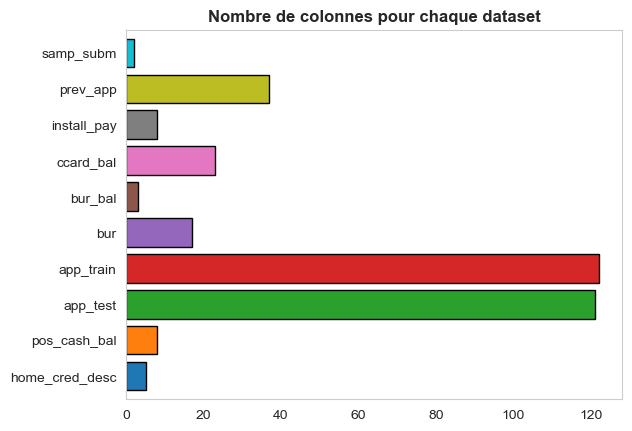

In [130]:
# Plot the number of columns of each data table
colors = sns.color_palette('tab10')[:df_missing.shape[0]]
df_missing.count().plot.barh(ec='k', color=colors, width=0.8)
plt.title('Nombre de colonnes pour chaque dataset', fontweight='bold')
plt.grid()

# <a id='toc3_'></a>[Préparation des données et feature engineering](#toc0_)

Afin de faciliter l’analyse exploratoire, la préparation des données et le feature engineering nécessaires à l’élaboration du modèle de scoring, nous nous basons sur un kernel Kaggle : https://www.kaggle.com/code/willkoehrsen/start-here-a-gentle-introduction/notebook

In [131]:
num_rows = None
df_datas = fc_application_train_test(path_datas=path_datas_init, num_rows=num_rows)

with fc_timer("Process bureau and bureau_balance"):
    df_bureau = fc_bureau_and_balance(path_datas=path_datas_init, num_rows=num_rows)
    print("Bureau df shape:", df_bureau.shape)
    df_datas = df_datas.join(df_bureau, how='left', on='SK_ID_CURR')
    del df_bureau
    gc.collect()

with fc_timer("Process credit card balance"):
    df_credit_card_balance = fc_credit_card_balance(path_datas=path_datas_init, num_rows=num_rows)
    print("Credit card balance df shape:", df_credit_card_balance.shape)
    df_datas = df_datas.join(df_credit_card_balance, how='left', on='SK_ID_CURR')
    del df_credit_card_balance
    gc.collect()

with fc_timer("Process installments payments"):
    df_installments_payments = fc_installments_payments(path_datas=path_datas_init, num_rows=num_rows)
    print("Installments payments df shape:", df_installments_payments.shape)
    df_datas = df_datas.join(df_installments_payments, how='left', on='SK_ID_CURR')
    del df_installments_payments
    gc.collect()

with fc_timer("Process POS-CASH balance"):
    df_pos_cash_balance = fc_pos_cash_balance(path_datas=path_datas_init, num_rows=num_rows)
    print("Pos-cash balance df shape:", df_pos_cash_balance.shape)
    df_datas = df_datas.join(df_pos_cash_balance, how='left', on='SK_ID_CURR')
    del df_pos_cash_balance
    gc.collect()

with fc_timer("Process previous_applications"):
    df_previous_application = fc_previous_application(path_datas=path_datas_init, num_rows=num_rows)
    print("Previous applications df shape:", df_previous_application.shape)
    df_datas = df_datas.join(df_previous_application, how='left', on='SK_ID_CURR')
    del df_previous_application
    gc.collect()

Taille des données d'entrainement: 307511, Taille des données de test: 48744
Bureau df shape: (305811, 116)
Process bureau and bureau_balance - réalisé en 13s
Credit card balance df shape: (103558, 141)
Process credit card balance - réalisé en 10s
Installments payments df shape: (339587, 26)
Process installments payments - réalisé en 14s
Pos-cash balance df shape: (337252, 18)
Process POS-CASH balance - réalisé en 7s
Previous applications df shape: (338857, 249)
Process previous_applications - réalisé en 53s


In [132]:
df_datas_train = df_datas[df_datas['TARGET'].notnull()]
df_datas_test = df_datas[df_datas['TARGET'].isnull()]
print("Taille des données d'entrainement: {}".format(len(df_datas_train)))
print("Taille des données de test: {}".format(len(df_datas_test)))

Taille des données d'entrainement: 307507
Taille des données de test: 48744


In [133]:
df_datas.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

In [134]:
df_datas_train.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

In [135]:
df_datas_test.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

In [136]:
df_datas_train.to_csv(path_datas_save + 'df_datas_train.csv', index = False)
df_datas_test.to_csv(path_datas_save + 'df_datas_test.csv', index = False)

# <a id='toc4_'></a>[Traitement des données](#toc0_)

In [137]:
df_datas_train_cleaned = df_datas_train.copy()
df_datas_test_cleaned = df_datas_test.copy()

**Doublons :**

In [138]:
print("Nombre de lignes dupliquées dans le jeu d'entrainement: {}".format(fc.data_duplicated(df_datas_train_cleaned)))
print("Nombre de lignes dupliquées dans le jeu de test: {}".format(fc.data_duplicated(df_datas_test_cleaned)))

Nombre de lignes dupliquées dans le jeu d'entrainement: 0
Nombre de lignes dupliquées dans le jeu de test: 0


Il n'y a pas de doublons dans notre jeu de données. 

**Données manquantes :**

In [139]:
print('Le dataset train :')
fc.missing_general(df_datas_train_cleaned)
print()
print('Le dataset test :')
fc.missing_general(df_datas_test_cleaned)

Le dataset train :
Nombre total de cellules manquantes : 63543491
Nombre de cellules manquantes en % : 25.93%

Le dataset test :
Nombre total de cellules manquantes : 8556450
Nombre de cellules manquantes en % : 22.02%


Nos deux dataset contiennent des données manquantes, voyons cela plus en détail.

In [140]:
fc.bar_missing(df_datas_train_cleaned)

In [141]:
df_datas_train_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307507 entries, 0 to 307510
Columns: 797 entries, SK_ID_CURR to REFUSED_CNT_PAYMENT_SUM
dtypes: float64(622), int32(133), int64(42)
memory usage: 1.7 GB


In [142]:
fc.bar_missing(df_datas_test_cleaned)

In [143]:
df_datas_test_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 48744 entries, 307511 to 356254
Columns: 797 entries, SK_ID_CURR to REFUSED_CNT_PAYMENT_SUM
dtypes: float64(622), int32(133), int64(42)
memory usage: 272.0 MB


Nous avons 797 features.

On commence par supprimer celles ayant plus de 50% de valeurs manquantes.

In [144]:
df_datas_train_cleaned = fc.drop_columns_empty(df_datas_train_cleaned, 0.5)

Suppression de la feature OWN_CAR_AGE avec un % de valeurs manquantes à 0.66
Suppression de la feature EXT_SOURCE_1 avec un % de valeurs manquantes à 0.56
Suppression de la feature APARTMENTS_AVG avec un % de valeurs manquantes à 0.51
Suppression de la feature BASEMENTAREA_AVG avec un % de valeurs manquantes à 0.59
Suppression de la feature YEARS_BUILD_AVG avec un % de valeurs manquantes à 0.66
Suppression de la feature COMMONAREA_AVG avec un % de valeurs manquantes à 0.7
Suppression de la feature ELEVATORS_AVG avec un % de valeurs manquantes à 0.53
Suppression de la feature ENTRANCES_AVG avec un % de valeurs manquantes à 0.5
Suppression de la feature FLOORSMIN_AVG avec un % de valeurs manquantes à 0.68
Suppression de la feature LANDAREA_AVG avec un % de valeurs manquantes à 0.59
Suppression de la feature LIVINGAPARTMENTS_AVG avec un % de valeurs manquantes à 0.68
Suppression de la feature LIVINGAREA_AVG avec un % de valeurs manquantes à 0.5
Suppression de la feature NONLIVINGAPARTMENT

In [145]:
df_datas_train_cleaned.shape

(307507, 561)

In [146]:
df_datas_test_cleaned = df_datas_test_cleaned[df_datas_train_cleaned.columns]
print(df_datas_test_cleaned.shape)

(48744, 561)


Il nous reste désormais 561 features.

Voyons plus en détail certaines d'entre elles.

**DAYS_BIRTH :**

La feature *'DAYS_BIRTH'* est négative car ce sont les jours enregistrés par rapport à la demande de prêt en cours. Nous allons donc transformer cette feature en nombre positif représentant des années.

In [147]:
df_datas_train_cleaned['DAYS_BIRTH'].describe()

count    307507.000000
mean     -16037.027271
std        4363.982424
min      -25229.000000
25%      -19682.000000
50%      -15750.000000
75%      -12413.000000
max       -7489.000000
Name: DAYS_BIRTH, dtype: float64

In [148]:
(df_datas_train_cleaned['DAYS_BIRTH'] / (-365)).describe()

count    307507.000000
mean         43.937061
std          11.956116
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

In [149]:
df_datas_train_cleaned['DAYS_BIRTH'] = df_datas_train_cleaned['DAYS_BIRTH'] / (-365)
df_datas_test_cleaned['DAYS_BIRTH'] = df_datas_test_cleaned['DAYS_BIRTH'] / (-365)

**Change les valeurs négatives en valeurs positives :**

In [150]:
# change les valeurs négatives en valeurs positives.
df_datas_train_cleaned[df_datas_train_cleaned.columns[(df_datas_train_cleaned < 0).any()].tolist()] = df_datas_train_cleaned[
               df_datas_train_cleaned.columns[(df_datas_train_cleaned < 0).any()].tolist()] * (-1)

df_datas_test_cleaned[df_datas_test_cleaned.columns[(df_datas_test_cleaned < 0).any()].tolist()] = df_datas_test_cleaned[
              df_datas_test_cleaned.columns[(df_datas_test_cleaned < 0).any()].tolist()] * (-1)

**DAYS_ID_PUBLISH :**

In [151]:
df_datas_train_cleaned['DAYS_ID_PUBLISH'] = df_datas_train_cleaned['DAYS_ID_PUBLISH'].astype(float)
df_datas_test_cleaned['DAYS_ID_PUBLISH'] = df_datas_test_cleaned['DAYS_ID_PUBLISH'].astype(float)

**DAYS_EMPLOYED :**

In [152]:
df_datas_train_cleaned['DAYS_EMPLOYED'].describe()

count    252133.000000
mean       2384.142254
std        2338.327666
min          -0.000000
25%         767.000000
50%        1648.000000
75%        3175.000000
max       17912.000000
Name: DAYS_EMPLOYED, dtype: float64

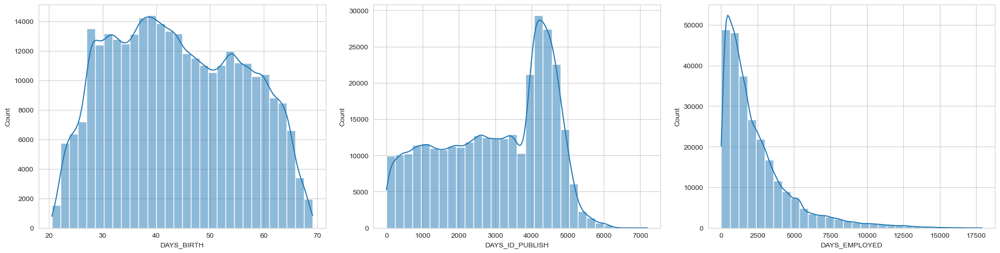

In [153]:
fc.distribution(df_datas_train_cleaned,['DAYS_BIRTH','DAYS_ID_PUBLISH','DAYS_EMPLOYED'],
                n_cols=3, fig=(20, 10))

**NAME__TYPES**

In [154]:
var_liste_categorie_name_type = [
    "NAME_EDUCATION_TYPE",
    "NAME_FAMILY_STATUS",
    "NAME_INCOME_TYPE",
    "NAME_HOUSING_TYPE",
    "NAME_TYPE_SUITE",
    "ORGANIZATION_TYPE",
    "OCCUPATION_TYPE"
]

In [155]:
def fn_categorie_name_type(row, col_liste_type):
    id_col = 0.0
    col_value = 0.0
    for col_type in col_liste_type:
        id_col += 1.0
        if (row[col_type] == 1):
            col_value = id_col
    return col_value

In [156]:
for var_categorie_name_type in var_liste_categorie_name_type:
    col_liste_categorie_name_type = df_datas_train.columns[df_datas_train.columns.str.contains(var_categorie_name_type + '_')]

    df_datas_train_cleaned[var_categorie_name_type] = df_datas_train_cleaned.apply(fn_categorie_name_type, axis=1, col_liste_type=col_liste_categorie_name_type)
    df_datas_test_cleaned[var_categorie_name_type] = df_datas_test_cleaned.apply(fn_categorie_name_type, axis=1, col_liste_type=col_liste_categorie_name_type)

    for col_categorie_name_type in col_liste_categorie_name_type:
        df_datas_train_cleaned = df_datas_train_cleaned.drop(col_categorie_name_type, axis=1)
        df_datas_test_cleaned = df_datas_test_cleaned.drop(col_categorie_name_type, axis=1)

In [157]:
df_datas_train_cleaned.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,FONDKAPREMONT_MODE_not specified,FONDKAPREMONT_MODE_org spec account,FONDKAPREMONT_MODE_reg oper account,FONDKAPREMONT_MODE_reg oper spec account,HOUSETYPE_MODE_block of flats,HOUSETYPE_MODE_specific housing,HOUSETYPE_MODE_terraced house,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,DAYS_EMPLOYED_PERC,INCOME_CREDIT_PERC,INCOME_PER_PERSON,ANNUITY_INCOME_PERC,PAYMENT_RATE,BURO_DAYS_CREDIT_MIN,BURO_DAYS_CREDIT_MAX,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_VAR,BURO_DAYS_CREDIT_ENDDATE_MIN,BURO_DAYS_CREDIT_ENDDATE_MAX,BURO_DAYS_CREDIT_ENDDATE_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_DAY_OVERDUE_MAX,BURO_CREDIT_DAY_OVERDUE_MEAN,BURO_AMT_CREDIT_MAX_OVERDUE_MEAN,BURO_AMT_CREDIT_SUM_MAX,BURO_AMT_CREDIT_SUM_MEAN,BURO_AMT_CREDIT_SUM_SUM,BURO_AMT_CREDIT_SUM_DEBT_MAX,BURO_AMT_CREDIT_SUM_DEBT_MEAN,BURO_AMT_CREDIT_SUM_DEBT_SUM,BURO_AMT_CREDIT_SUM_OVERDUE_MEAN,BURO_AMT_CREDIT_SUM_LIMIT_MEAN,BURO_AMT_CREDIT_SUM_LIMIT_SUM,BURO_CNT_CREDIT_PROLONG_SUM,BURO_MONTHS_BALANCE_SIZE_SUM,BURO_CREDIT_ACTIVE_Active_MEAN,BURO_CREDIT_ACTIVE_Bad debt_MEAN,BURO_CREDIT_ACTIVE_Closed_MEAN,BURO_CREDIT_ACTIVE_Sold_MEAN,BURO_CREDIT_ACTIVE_nan_MEAN,BURO_CREDIT_CURRENCY_currency 1_MEAN,BURO_CREDIT_CURRENCY_currency 2_MEAN,BURO_CREDIT_CURRENCY_currency 3_MEAN,BURO_CREDIT_CURRENCY_currency 4_MEAN,BURO_CREDIT_CURRENCY_nan_MEAN,BURO_CREDIT_TYPE_Another type of loan_MEAN,BURO_CREDIT_TYPE_Car loan_MEAN,BURO_CREDIT_TYPE_Cash loan (non-earmarked)_MEAN,BURO_CREDIT_TYPE_Consumer credit_MEAN,BURO_CREDIT_TYPE_Credit card_MEAN,BURO_CREDIT_TYPE_Interbank credit_MEAN,BURO_CREDIT_TYPE_Loan for business development_MEAN,BURO_CREDIT_TYPE_Loan for purchase of shares (margin lending)_MEAN,BURO_CREDIT_TYPE_Loan for the purchase of equipment_MEAN,BURO_CREDIT_TYPE_Loan for working capital replenishment_MEAN,BURO_CREDIT_TYPE_Microloan_MEAN,BURO_CREDIT_TYPE_Mobile operator loan_MEAN,BURO_CREDIT_TYPE_Mortgage_MEAN,BURO_CREDIT_TYPE_Real estate loan_MEAN,BURO_CREDIT_TYPE_Unknown type of loan_MEAN,BURO_CREDIT_TYPE_nan_MEAN,ACTIVE_DAYS_CREDIT_MIN,ACTIVE_DAYS_CREDIT_MAX,ACTIVE_DAYS_CREDIT_MEAN,ACTIVE_DAYS_CREDIT_ENDDATE_MIN,ACTIVE_DAYS_CREDIT_ENDDATE_MAX,ACTIVE_DAYS_CREDIT_ENDDATE_MEAN,ACTIVE_DAYS_CREDIT_U

In [158]:
df_datas_test_cleaned.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,FONDKAPREMONT_MODE_not specified,FONDKAPREMONT_MODE_org spec account,FONDKAPREMONT_MODE_reg oper account,FONDKAPREMONT_MODE_reg oper spec account,HOUSETYPE_MODE_block of flats,HOUSETYPE_MODE_specific housing,HOUSETYPE_MODE_terraced house,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,DAYS_EMPLOYED_PERC,INCOME_CREDIT_PERC,INCOME_PER_PERSON,ANNUITY_INCOME_PERC,PAYMENT_RATE,BURO_DAYS_CREDIT_MIN,BURO_DAYS_CREDIT_MAX,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_VAR,BURO_DAYS_CREDIT_ENDDATE_MIN,BURO_DAYS_CREDIT_ENDDATE_MAX,BURO_DAYS_CREDIT_ENDDATE_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_DAY_OVERDUE_MAX,BURO_CREDIT_DAY_OVERDUE_MEAN,BURO_AMT_CREDIT_MAX_OVERDUE_MEAN,BURO_AMT_CREDIT_SUM_MAX,BURO_AMT_CREDIT_SUM_MEAN,BURO_AMT_CREDIT_SUM_SUM,BURO_AMT_CREDIT_SUM_DEBT_MAX,BURO_AMT_CREDIT_SUM_DEBT_MEAN,BURO_AMT_CREDIT_SUM_DEBT_SUM,BURO_AMT_CREDIT_SUM_OVERDUE_MEAN,BURO_AMT_CREDIT_SUM_LIMIT_MEAN,BURO_AMT_CREDIT_SUM_LIMIT_SUM,BURO_CNT_CREDIT_PROLONG_SUM,BURO_MONTHS_BALANCE_SIZE_SUM,BURO_CREDIT_ACTIVE_Active_MEAN,BURO_CREDIT_ACTIVE_Bad debt_MEAN,BURO_CREDIT_ACTIVE_Closed_MEAN,BURO_CREDIT_ACTIVE_Sold_MEAN,BURO_CREDIT_ACTIVE_nan_MEAN,BURO_CREDIT_CURRENCY_currency 1_MEAN,BURO_CREDIT_CURRENCY_currency 2_MEAN,BURO_CREDIT_CURRENCY_currency 3_MEAN,BURO_CREDIT_CURRENCY_currency 4_MEAN,BURO_CREDIT_CURRENCY_nan_MEAN,BURO_CREDIT_TYPE_Another type of loan_MEAN,BURO_CREDIT_TYPE_Car loan_MEAN,BURO_CREDIT_TYPE_Cash loan (non-earmarked)_MEAN,BURO_CREDIT_TYPE_Consumer credit_MEAN,BURO_CREDIT_TYPE_Credit card_MEAN,BURO_CREDIT_TYPE_Interbank credit_MEAN,BURO_CREDIT_TYPE_Loan for business development_MEAN,BURO_CREDIT_TYPE_Loan for purchase of shares (margin lending)_MEAN,BURO_CREDIT_TYPE_Loan for the purchase of equipment_MEAN,BURO_CREDIT_TYPE_Loan for working capital replenishment_MEAN,BURO_CREDIT_TYPE_Microloan_MEAN,BURO_CREDIT_TYPE_Mobile operator loan_MEAN,BURO_CREDIT_TYPE_Mortgage_MEAN,BURO_CREDIT_TYPE_Real estate loan_MEAN,BURO_CREDIT_TYPE_Unknown type of loan_MEAN,BURO_CREDIT_TYPE_nan_MEAN,ACTIVE_DAYS_CREDIT_MIN,ACTIVE_DAYS_CREDIT_MAX,ACTIVE_DAYS_CREDIT_MEAN,ACTIVE_DAYS_CREDIT_ENDDATE_MIN,ACTIVE_DAYS_CREDIT_ENDDATE_MAX,ACTIVE_DAYS_CREDIT_ENDDATE_MEAN,ACTIVE_DAYS_CREDIT_U

**TARGET :**

Transformons notre variable *'TARGET'* en entier et supprimons cette variable de notre test set.

In [159]:
df_datas_train_cleaned['TARGET'] = df_datas_train_cleaned['TARGET'].astype(int)

In [160]:
df_datas_test_cleaned = df_datas_test_cleaned.drop('TARGET',axis=1)

**NAN infinies :**

Remplacons désormais les valeurs infinies par NaN avant de procéder à une imputation.

In [161]:
df_datas_train_cleaned = df_datas_train_cleaned.replace(np.inf, np.nan)
df_datas_test_cleaned = df_datas_test_cleaned.replace(np.inf, np.nan)

In [162]:
df_datas_train_cleaned.to_csv(path_datas_save + 'df_datas_train_nan.csv', index = False)
df_datas_test_cleaned.to_csv(path_datas_save + 'df_datas_test_nan.csv', index = False)

**Imputation**

Nous allons appliquer différentes méthodes d'imputation simples. Tout d'abord, pour les colonnes qui proviennent de l'aggrégation, nous allons remplacer les valeurs manquantes par *0.0*. Pour les variables quantitatives restantes, nous remplacerons par la médiane. Enfin, pour les variables qualitatives/catégorielles, nous remplacerons par le mode (soit la valeur la plus fréquente).

In [163]:
df_datas_train_cleaned.dtypes

SK_ID_CURR                                                                 int64
TARGET                                                                     int32
CODE_GENDER                                                                int64
FLAG_OWN_CAR                                                               int64
FLAG_OWN_REALTY                                                            int64
CNT_CHILDREN                                                               int64
AMT_INCOME_TOTAL                                                         float64
AMT_CREDIT                                                               float64
AMT_ANNUITY                                                              float64
AMT_GOODS_PRICE                                                          float64
REGION_POPULATION_RELATIVE                                               float64
DAYS_BIRTH                                                               float64
DAYS_EMPLOYED               

In [164]:
quanti_col = df_datas_train_cleaned.select_dtypes(['float64']).columns
quali_col = df_datas_train_cleaned.select_dtypes(['int32', 'int64']).columns
quali_col = quali_col.drop('TARGET')

In [165]:
# imputation des variables quantitatives issues de l'aggrégation
col_agg = df_datas_train_cleaned.columns[df_datas_train_cleaned.columns.str.contains('_MIN|_MAX|_MEAN|_VAR|_SUM|_SIZE')]

df_datas_train_cleaned[col_agg] = df_datas_train_cleaned[col_agg].fillna(0.0)
df_datas_test_cleaned[col_agg] = df_datas_test_cleaned[col_agg].fillna(0.0)

In [166]:
# imputation des variables quantitatives restantes
quanti_col_rest = [col for col in quanti_col if col not in col_agg]
for col in quanti_col_rest:
    median_train = df_datas_train_cleaned[col].median()
    median_test = df_datas_test_cleaned[col].median()
    df_datas_train_cleaned[col] = df_datas_train_cleaned[col].fillna(median_train)
    df_datas_test_cleaned[col] = df_datas_test_cleaned[col].fillna(median_test)

In [167]:
# imputation des variables qualitatives
for col in quali_col:
    mode_train = df_datas_train_cleaned[col].mode()[0]
    mode_test = df_datas_test_cleaned[col].mode()[0]
    df_datas_train_cleaned[col] = df_datas_train_cleaned[col].fillna(mode_train)
    df_datas_test_cleaned[col] = df_datas_test_cleaned[col].fillna(mode_test)

In [168]:
print('Le dataset train :')
fc.missing_general(df_datas_train_cleaned)
print()
print('Le dataset test :')
fc.missing_general(df_datas_test_cleaned)

Le dataset train :
Nombre total de cellules manquantes : 0
Nombre de cellules manquantes en % : 0.00%

Le dataset test :
Nombre total de cellules manquantes : 0
Nombre de cellules manquantes en % : 0.00%


# <a id='toc5_'></a>[Réduction de features](#toc0_)

In [169]:
df_datas_train_cleaned.shape

(307507, 452)

A ce stade nous faisons face à un problème de taille de données :
- Nous avons 307 507 individus
- Nous avons 561 features

Deux options sont possibles :
- Réduire la dimensionnalité (le nombre de features) par exclusion des valeurs trop corrélées ou à faible variance.
- Réduire le nombre d'individus que l'on va soumettre aux modèles par sampling.

**Protect list**

In [170]:
# Mise en place d'une liste de features que l'on souhaite conserver
protect_list = [
    "SK_ID_CURR",
    "CODE_GENDER",
    "TARGET",
    "DAYS_BIRTH",
    "CNT_CHILDREN",
    "DAYS_EMPLOYED",
    "DAYS_ID_PUBLISH",
    "AMT_INCOME_TOTAL",
    "PAYMENT_RATE",
    "NUM_INSTALMENT_VERSION",
    "DPD",
    "DBD",
    "PAYMENT_PERC",
    "PAYMENT_DIFF",
    "AMT_INSTALMENT",
    "AMT_PAYMENT",
    "DAYS_ENTRY_PAYMENT",
    "AMT_ANNUITY",
    "AMT_APPLICATION",
    "AMT_CREDIT",
    "APP_CREDIT_PERC",
    "AMT_DOWN_PAYMENT",
    "AMT_GOODS_PRICE",
    "HOUR_APPR_PROCESS_START",
    "RATE_DOWN_PAYMENT",
    "DAYS_DECISION",
    "CNT_PAYMENT",
    "DAYS_CREDIT",
    "DAYS_CREDIT_ENDDATE",
    "DAYS_CREDIT_UPDATE",
    "CREDIT_DAY_OVERDUE",
    "AMT_CREDIT_MAX_OVERDUE",
    "AMT_CREDIT_SUM",
    "AMT_CREDIT_SUM_DEBT",
    "AMT_CREDIT_SUM_OVERDUE",
    "AMT_CREDIT_SUM_LIMIT",
    "CNT_CREDIT_PROLONG",
    "MONTHS_BALANCE_MIN",
    "MONTHS_BALANCE_MAX",
    "MONTHS_BALANCE_SIZE",
    "DAYS_EMPLOYED_PERC",
    "INCOME_CREDIT_PERC",
    "INCOME_PER_PERSON",
    "ANNUITY_INCOME_PERC",
    "PAYMENT_RATE",
    "NAME_EDUCATION_TYPE",
    "NAME_FAMILY_STATUS",
    "NAME_INCOME_TYPE",
    "NAME_HOUSING_TYPE",
    "NAME_TYPE_SUITE",
    "ORGANIZATION_TYPE",
    "OCCUPATION_TYPE",
    "FLAG_OWN_REALTY",
    "FLAG_OWN_CAR"
]

**Suppression des features à forte corrélation : High Correlation Filtering**

Nous pouvons considérer les valeurs "usuelles" suivantes pour les corrélations :
- 0,00-0,19 corrélation "très faible"
- 0,20 à 0,39 corrélation "faible"
- 0,40-0,59 corrélation "modéré"
- 0,60-0,79 corrélation "forte"
- 0,80-1,0 corrélation "très forte"

In [171]:
# calcule la correlation
cor_matrix = df_datas_train_cleaned.corr()

if not os.path.isfile('models/correlation_matrix.pkl'):
    joblib.dump(cor_matrix,'models/correlation_matrix.pkl')
else:
    print("Le fichier 'models/correlation_matrix.pkl' existe déjà.")

# Create triangular matrix
triangular_matrix = cor_matrix.where(np.triu(np.ones(cor_matrix.shape), k=1).astype(bool))

Le fichier 'models/correlation_matrix.pkl' existe déjà.


In [172]:
correlation_features = [
    column
    for column in triangular_matrix.columns
    if any(triangular_matrix[column] > 0.80)
]

In [173]:
correlation_features = [elt for elt in correlation_features if elt not in protect_list]

In [174]:
correlation_features

['CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT_W_CITY',
 'LIVE_REGION_NOT_WORK_REGION',
 'LIVE_CITY_NOT_WORK_CITY',
 'YEARS_BEGINEXPLUATATION_MODE',
 'FLOORSMAX_MODE',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'FLOORSMAX_MEDI',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'EMERGENCYSTATE_MODE_No',
 'BURO_DAYS_CREDIT_MEAN',
 'BURO_DAYS_CREDIT_UPDATE_MEAN',
 'BURO_AMT_CREDIT_SUM_MEAN',
 'BURO_AMT_CREDIT_SUM_SUM',
 'BURO_AMT_CREDIT_SUM_DEBT_SUM',
 'ACTIVE_DAYS_CREDIT_MEAN',
 'ACTIVE_DAYS_CREDIT_ENDDATE_MAX',
 'ACTIVE_DAYS_CREDIT_ENDDATE_MEAN',
 'ACTIVE_CREDIT_DAY_OVERDUE_MAX',
 'ACTIVE_CREDIT_DAY_OVERDUE_MEAN',
 'ACTIVE_AMT_CREDIT_SUM_MEAN',
 'ACTIVE_AMT_CREDIT_SUM_SUM',
 'ACTIVE_AMT_CREDIT_SUM_DEBT_MAX',
 'ACTIVE_AMT_CREDIT_SUM_DEBT_MEAN',
 'ACTIVE_AMT_CREDIT_SUM_DEBT_SUM',
 'ACTIVE_AMT_CREDIT_SUM_LIMIT_MEAN',
 'ACTIVE_AMT_CREDIT_SUM_LIMIT_SUM',
 'ACTIVE_CNT_CREDIT_PROLONG_SUM',
 'CLOSED_DAYS_CREDIT_MIN',
 'CLOSED_DAYS_CREDIT_MEAN',
 'CLOSED_DAYS_CREDIT_UPDATE_MEAN',
 'CLOSED_AMT_CREDI

In [175]:
# Suppression des features qui sont fortement corrélées (> 0.80)
df_datas_train_cleaned = df_datas_train_cleaned.drop(correlation_features, axis=1, errors="ignore")
df_datas_train_cleaned.shape

(307507, 342)

Le nombre de features est passé à 450

**Suppression des features à faible variance : Low Variance Filtering**

- La plupart des modèles sont plus performants lorsqu'ils sont en présence de features à forte variance.
- Si la variance d'une feature est faible ou proche de zéro, alors cette feature est approximativement constante et n'améliorera pas les performances du modèle. Dans ce cas, elle peut être supprimée.

In [176]:
variance_threshold_value = 0.02
vt = VarianceThreshold(threshold=variance_threshold_value)
vt_fit = vt.fit(df_datas_train_cleaned)

In [177]:
len(vt_fit.get_feature_names_out())

178

In [178]:
variance_features = [
    column
    for column in df_datas_train_cleaned.columns
    if column not in df_datas_train_cleaned.columns[vt_fit.get_support()]
]
variance_features = [column for column in variance_features if column not in protect_list]
len(variance_features)

161

In [179]:
# création du dataframe associé à la réduction de features
df_datas_train_cleaned = df_datas_train_cleaned.drop(variance_features, axis=1, errors="ignore")
df_datas_test_cleaned = df_datas_test_cleaned.drop(variance_features, axis=1, errors="ignore")
df_datas_train_cleaned.shape

(307507, 181)

**Réduire le nombre de features par la méthode SelectKBest**

In [180]:
X_train = df_datas_train_cleaned.loc[:, df_datas_train_cleaned.columns != 'TARGET']
y_train = df_datas_train_cleaned.loc[:, df_datas_train_cleaned.columns == 'TARGET']

In [181]:
print(X_train.shape)
print(y_train.shape)

(307507, 180)
(307507, 1)


In [182]:
selectkbest_features = SelectKBest(k=30).fit(X_train, y_train)

In [183]:
selectkbest_features

SelectKBest(k=30)

In [184]:
df_selectkbest_features = pd.DataFrame({'Feature':list(X_train.columns),
                                        'Scores':selectkbest_features.scores_})
kbest_score = df_selectkbest_features.sort_values(by='Scores', ascending=False).reset_index(drop=True)
kbest_score

,Feature,Scores
0,EXT_SOURCE_2,8109.493617
1,EXT_SOURCE_3,7659.890000
2,DAYS_BIRTH,1894.090368
3,PREV_NAME_CONTRACT_STATUS_Refused_MEAN,1877.607853
4,BURO_CREDIT_ACTIVE_Closed_MEAN,1810.199567
5,BURO_DAYS_CREDIT_MIN,1641.479192
6,DAYS_EMPLOYED,1239.695545
7,REGION_RATING_CLIENT,1070.545333
8,PREV_NAME_PRODUCT_TYPE_walk-in_MEAN,1031.113132
9,DAYS_EMPLOYED_PERC,1021.206891


In [185]:
X_train_kbest = selectkbest_features.transform(X_train)
print(X_train_kbest.shape)

(307507, 30)


Starting LightGBM. Train shape: (307507, 31)
Training until validation scores don't improve for 200 rounds
[200]	training's auc: 0.763712	training's binary_logloss: 0.243385	valid_1's auc: 0.743456	valid_1's binary_logloss: 0.253254
[400]	training's auc: 0.778405	training's binary_logloss: 0.238616	valid_1's auc: 0.746529	valid_1's binary_logloss: 0.252327
[600]	training's auc: 0.78976	training's binary_logloss: 0.235091	valid_1's auc: 0.746885	valid_1's binary_logloss: 0.252234
Early stopping, best iteration is:
[596]	training's auc: 0.789565	training's binary_logloss: 0.235155	valid_1's auc: 0.746888	valid_1's binary_logloss: 0.252231
Fold  1 AUC : 0.7469


Training until validation scores don't improve for 200 rounds
[200]	training's auc: 0.762476	training's binary_logloss: 0.246472	valid_1's auc: 0.743514	valid_1's binary_logloss: 0.247461
[400]	training's auc: 0.776829	training's binary_logloss: 0.241728	valid_1's auc: 0.746609	valid_1's binary_logloss: 0.246464
[600]	training's a

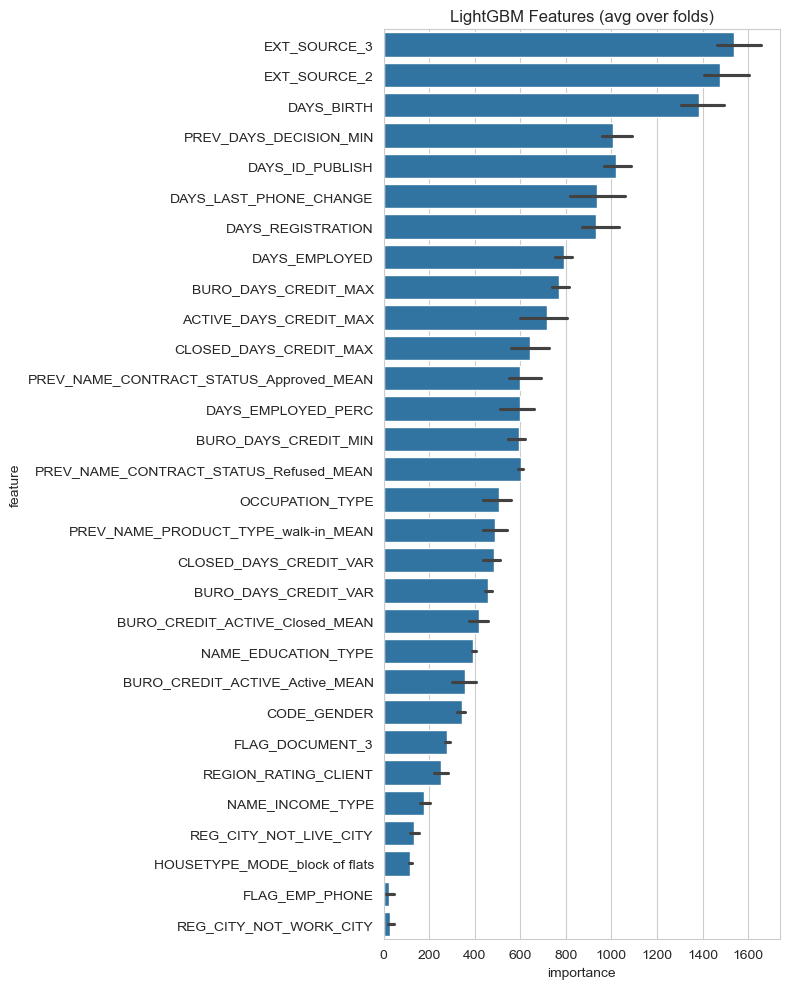

In [186]:
features_to_keep = list(kbest_score.iloc[:30, 0])
df_datas_train_kbest= df_datas_train_cleaned[features_to_keep]
df_datas_train_kbest['TARGET'] = df_datas_train_cleaned['TARGET']
feat_importance = fc.kfold_lightgbm(df_datas_train_kbest, num_folds=3)

In [187]:
df_datas_train_kbest.columns

Index(['EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH',
       'PREV_NAME_CONTRACT_STATUS_Refused_MEAN',
       'BURO_CREDIT_ACTIVE_Closed_MEAN', 'BURO_DAYS_CREDIT_MIN',
       'DAYS_EMPLOYED', 'REGION_RATING_CLIENT',
       'PREV_NAME_PRODUCT_TYPE_walk-in_MEAN', 'DAYS_EMPLOYED_PERC',
       'DAYS_LAST_PHONE_CHANGE', 'CODE_GENDER', 'NAME_EDUCATION_TYPE',
       'BURO_DAYS_CREDIT_MAX', 'DAYS_ID_PUBLISH', 'REG_CITY_NOT_WORK_CITY',
       'CLOSED_DAYS_CREDIT_MAX', 'BURO_CREDIT_ACTIVE_Active_MEAN',
       'NAME_INCOME_TYPE', 'FLAG_EMP_PHONE', 'REG_CITY_NOT_LIVE_CITY',
       'FLAG_DOCUMENT_3', 'ACTIVE_DAYS_CREDIT_MAX', 'BURO_DAYS_CREDIT_VAR',
       'DAYS_REGISTRATION', 'CLOSED_DAYS_CREDIT_VAR',
       'PREV_NAME_CONTRACT_STATUS_Approved_MEAN', 'PREV_DAYS_DECISION_MIN',
       'OCCUPATION_TYPE', 'HOUSETYPE_MODE_block of flats', 'TARGET'],
      dtype='object')

**Colonnes à ajouter :**

In [188]:
liste_colonnes_a_ajouter = [
    "SK_ID_CURR",
    "CNT_CHILDREN",
    "AMT_INCOME_TOTAL",
    "AMT_CREDIT",
    "AMT_ANNUITY",
    "AMT_GOODS_PRICE",
    "NAME_EDUCATION_TYPE",
    "NAME_FAMILY_STATUS",
    "NAME_INCOME_TYPE",
    "NAME_HOUSING_TYPE",
    "NAME_TYPE_SUITE",
    "ORGANIZATION_TYPE",
    "OCCUPATION_TYPE",
    "FLAG_OWN_REALTY",
    "FLAG_OWN_CAR"
]

In [189]:
# for colonne_a_ajouter in liste_colonnes_a_ajouter:
#     if colonne_a_ajouter not in df.columns:
#         df_datas_train_kbest[colonne_a_ajouter] = df_datas_train_cleaned[colonne_a_ajouter]

In [190]:
for colonne_a_ajouter in liste_colonnes_a_ajouter:
    df_datas_train_kbest[colonne_a_ajouter] = df_datas_train_cleaned[colonne_a_ajouter]

In [191]:
df_datas_train_kbest.shape

(307507, 43)

In [192]:
df_datas_train_cleaned = df_datas_train_kbest

In [193]:
df_datas_train_cleaned.shape

(307507, 43)

In [194]:
df_datas_train_without_target = df_datas_train_cleaned.drop('TARGET',axis=1)
df_datas_test_cleaned = df_datas_test_cleaned[df_datas_train_without_target.columns]

In [195]:
df_datas_test_cleaned.shape

(48744, 42)

# <a id='toc6_'></a>[Etude de la corrélation entre Target/Features](#toc0_)

<Axes: >

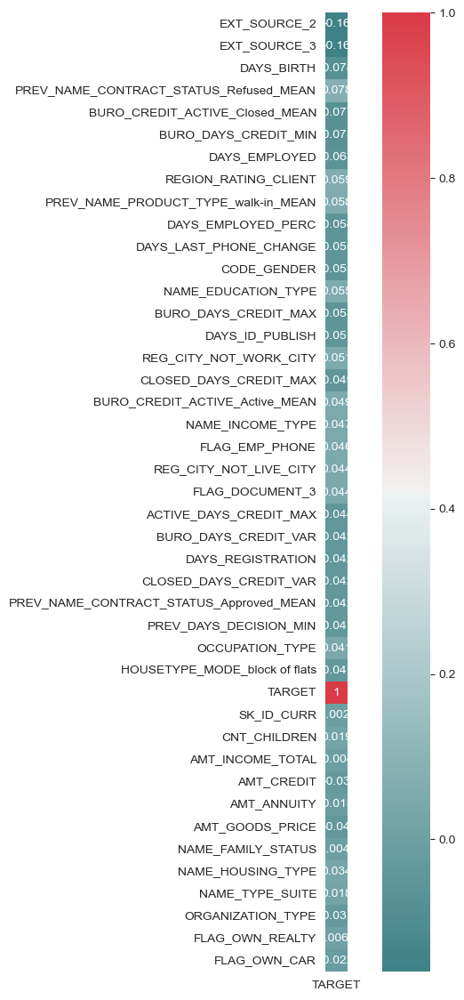

In [196]:
targets = ['TARGET']

# Compute the correlation matrix
corr = df_datas_train_cleaned.corr()
corr1 = corr.loc[:, targets]
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr1, dtype=bool))

# Set up the matplotlib figure
fig = plt.figure(1, figsize=(10, 14))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
#sns.heatmap(corr1, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0.1,
           # square=True, annot=True, linewidths=.5, cbar_kws={"shrink": .5});


sns.heatmap(corr1,annot=True,cmap=sns.diverging_palette(200, 10, as_cmap=True),
            square=True)

Je n'observe pas de corrélations aberrantes avec la sortie ('TARGET'), le data leaking est donc évité à ce niveau.

**Corrélation finale après réduction de features**

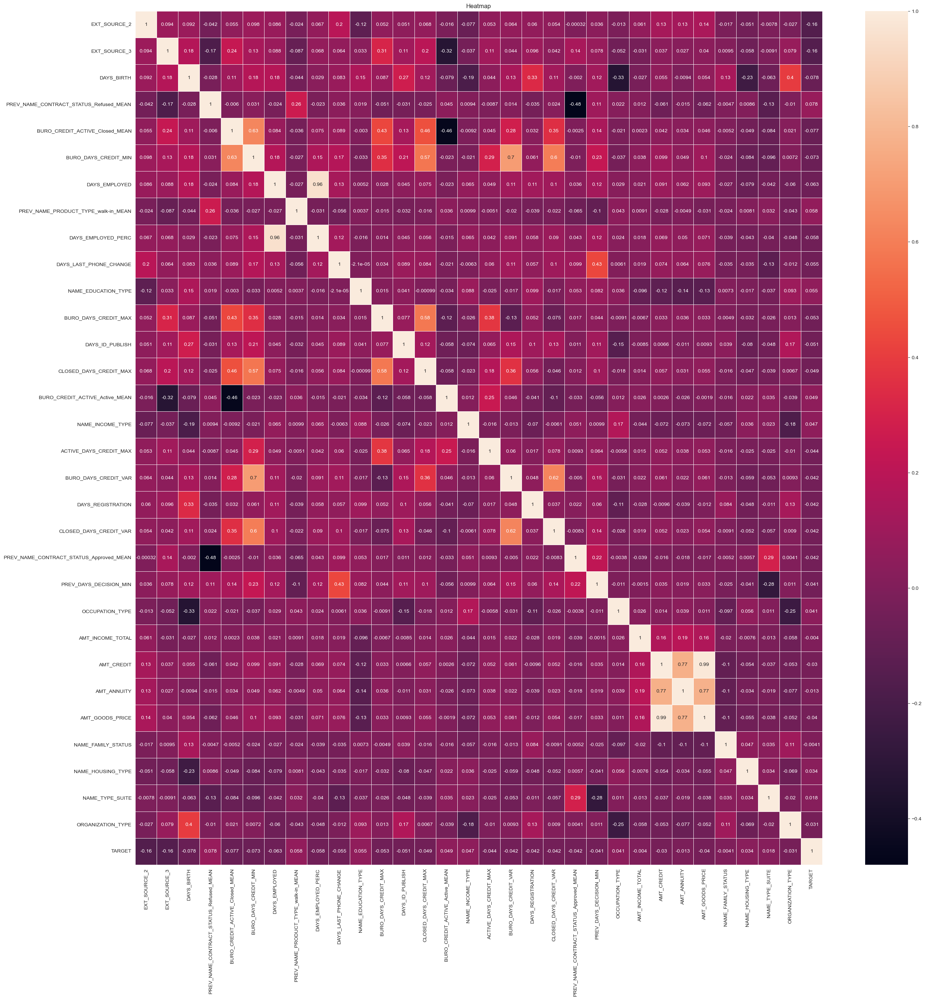

In [197]:
quanti_col = df_datas_train_cleaned.select_dtypes(['float64']).columns
col_quant = list(quanti_col)
col_quant.append('TARGET')
df_corr = df_datas_train_cleaned[col_quant].corr()
fc.heat_map(df_corr)

In [198]:
# calcule des correlations positives entre les variables et la variable TARGET
df_corr = df_datas_train_cleaned[df_datas_train_cleaned.select_dtypes(['int','float']).columns.to_list()].corr()['TARGET'].sort_values(ascending = False)

# Les 10 plus importantes corrélations positives
print('-------Les 10 plus importantes corrélations positives--------')
print(df_corr.head(10))
print('\n-------Les 10 plus importantes corrélations négatives-------')
# Les 10 plus importantes corrélations négatives
print(df_corr.tail(10))
print('\n-------Les 10 plus importantes corrélations---------------')
# Les 10 plus importantes corrélations
(abs(df_corr)).sort_values(ascending = False).head(10)

-------Les 10 plus importantes corrélations positives--------
TARGET                                    1.000000
PREV_NAME_CONTRACT_STATUS_Refused_MEAN    0.077903
REGION_RATING_CLIENT                      0.058901
PREV_NAME_PRODUCT_TYPE_walk-in_MEAN       0.057810
NAME_EDUCATION_TYPE                       0.054698
REG_CITY_NOT_WORK_CITY                    0.050992
BURO_CREDIT_ACTIVE_Active_MEAN            0.048707
NAME_INCOME_TYPE                          0.046831
FLAG_EMP_PHONE                            0.045984
REG_CITY_NOT_LIVE_CITY                    0.044394
Name: TARGET, dtype: float64

-------Les 10 plus importantes corrélations négatives-------
BURO_DAYS_CREDIT_MAX             -0.052742
CODE_GENDER                      -0.054710
DAYS_LAST_PHONE_CHANGE           -0.055219
DAYS_EMPLOYED_PERC               -0.057532
DAYS_EMPLOYED                    -0.063366
BURO_DAYS_CREDIT_MIN             -0.072868
BURO_CREDIT_ACTIVE_Closed_MEAN   -0.076500
DAYS_BIRTH                       -0.

TARGET                                    1.000000
EXT_SOURCE_2                              0.160294
EXT_SOURCE_3                              0.155899
DAYS_BIRTH                                0.078242
PREV_NAME_CONTRACT_STATUS_Refused_MEAN    0.077903
BURO_CREDIT_ACTIVE_Closed_MEAN            0.076500
BURO_DAYS_CREDIT_MIN                      0.072868
DAYS_EMPLOYED                             0.063366
REGION_RATING_CLIENT                      0.058901
PREV_NAME_PRODUCT_TYPE_walk-in_MEAN       0.057810
Name: TARGET, dtype: float64

# <a id='toc7_'></a>[Sauvegarde](#toc0_)

In [199]:
# Nous devons retirer les caractères spéciaux des noms des features pour l'utilisation de certains modèles (LightGBM)
df_datas_train_cleaned = df_datas_train_cleaned.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
df_datas_test_cleaned = df_datas_test_cleaned.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [200]:
df_datas_train_cleaned.head()

,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH,PREV_NAME_CONTRACT_STATUS_Refused_MEAN,BURO_CREDIT_ACTIVE_Closed_MEAN,BURO_DAYS_CREDIT_MIN,DAYS_EMPLOYED,REGION_RATING_CLIENT,PREV_NAME_PRODUCT_TYPE_walkin_MEAN,DAYS_EMPLOYED_PERC,DAYS_LAST_PHONE_CHANGE,CODE_GENDER,NAME_EDUCATION_TYPE,BURO_DAYS_CREDIT_MAX,DAYS_ID_PUBLISH,REG_CITY_NOT_WORK_CITY,CLOSED_DAYS_CREDIT_MAX,BURO_CREDIT_ACTIVE_Active_MEAN,NAME_INCOME_TYPE,FLAG_EMP_PHONE,REG_CITY_NOT_LIVE_CITY,FLAG_DOCUMENT_3,ACTIVE_DAYS_CREDIT_MAX,BURO_DAYS_CREDIT_VAR,DAYS_REGISTRATION,CLOSED_DAYS_CREDIT_VAR,PREV_NAME_CONTRACT_STATUS_Approved_MEAN,PREV_DAYS_DECISION_MIN,OCCUPATION_TYPE,HOUSETYPE_MODE_blockofflats,TARGET,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,NAME_TYPE_SUITE,ORGANIZATION_TYPE,FLAG_OWN_REALTY,FLAG_OWN_CAR
0,0.262949,0.139376,25.920548,0.000000,0.75,1437.0,637.0,2,0.000000,0.067329,1134.0,0,5.0,103.0,2120.0,0,476.0,0.25,8.0,1,0,1,103.0,186150.000000,3648.0,123956.700000,1.000000,606.0,9.0,1,1,100002,0,202500.0,406597.5,24700.5,351000.0,4.0,2.0,15.0,6.0,0,0
1,0.622246,0.535276,45.931507,0.000000,0.75,2586.0,1188.0,1,0.000000,0.070862,828.0,1,2.0,606.0,291.0,0,775.0,0.25,5.0,1,0,1,606.0,827783.583333,1186.0,820590.333333,1.000000,2341.0,4.0,1,0,100003,0,270000.0,1293502.5,35698.5,1129500.0,2.0,2.0,2.0,40.0,1,0
2,0.555912,0.729567,52.180822,0.000000,1.00,1326.0,225.0,2,0.000000,0.011814,815.0,0,5.0,408.0,2531.0,0,408.0,0.00,8.0,1,0,0,0.0,421362.000000,4260.0,421362.000000,1.000000,815.0,9.0,0,0,100004,0,67500.0,135000.0,6750.0,135000.0,4.0,2.0,14.0,12.0,0,1
3,0.650442,0.535276,52.068493,0.111111,0.00,0.0,3039.0,2,0.000000,0.159905,617.0,1,5.0,0.0,2437.0,0,0.0,0.00,8.0,1,0,1,0.0,0.000000,9833.0,0.000000,0.555556,617.0,9.0,0,0,100006,0,135000.0,312682.5,29686.5,297000.0,1.0,2.0,7.0,6.0,0,0
4,0.322738,0.535276,54.608219,0.000000,1.00,1149.0,3038.0,2,0.166667,0.152418,1106.0,0,5.0,1149.0,3458.0,1,1149.0,0.00,8.0,1,0,0,0.0,0.000000,4311.0,0.000000,1.000000,2357.0,4.0,0,0,100007,0,121500.0,513000.0,21865.5,513000.0,4.0,2.0,7.0,38.0,0,0


In [201]:
df_datas_test_cleaned.head()

,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH,PREV_NAME_CONTRACT_STATUS_Refused_MEAN,BURO_CREDIT_ACTIVE_Closed_MEAN,BURO_DAYS_CREDIT_MIN,DAYS_EMPLOYED,REGION_RATING_CLIENT,PREV_NAME_PRODUCT_TYPE_walkin_MEAN,DAYS_EMPLOYED_PERC,DAYS_LAST_PHONE_CHANGE,CODE_GENDER,NAME_EDUCATION_TYPE,BURO_DAYS_CREDIT_MAX,DAYS_ID_PUBLISH,REG_CITY_NOT_WORK_CITY,CLOSED_DAYS_CREDIT_MAX,BURO_CREDIT_ACTIVE_Active_MEAN,NAME_INCOME_TYPE,FLAG_EMP_PHONE,REG_CITY_NOT_LIVE_CITY,FLAG_DOCUMENT_3,ACTIVE_DAYS_CREDIT_MAX,BURO_DAYS_CREDIT_VAR,DAYS_REGISTRATION,CLOSED_DAYS_CREDIT_VAR,PREV_NAME_CONTRACT_STATUS_Approved_MEAN,PREV_DAYS_DECISION_MIN,OCCUPATION_TYPE,HOUSETYPE_MODE_blockofflats,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,NAME_TYPE_SUITE,ORGANIZATION_TYPE,FLAG_OWN_REALTY,FLAG_OWN_CAR
307511,0.789654,0.159520,52.715068,0.0,0.571429,1572.0,2329.0,2,0.0,0.121044,1740.0,1,2.0,49.0,812.0,0,857.0,0.428571,8.0,1,0,1,49.0,240043.666667,5170.0,119594.250000,1.00,1740.0,0.0,1,100001,0,135000.0,568800.0,20560.5,450000.0,2.0,2.0,9.0,29.0,0,0
307512,0.291656,0.432962,49.490411,0.0,0.333333,373.0,4469.0,2,0.0,0.247398,-0.0,0,5.0,62.0,1623.0,0,373.0,0.666667,8.0,1,0,1,62.0,26340.333333,9118.0,0.000000,0.50,757.0,10.0,0,100005,0,99000.0,222768.0,17370.0,180000.0,2.0,2.0,15.0,43.0,0,0
307513,0.699787,0.610991,54.898630,0.0,1.000000,2070.0,4458.0,2,0.0,0.222477,856.0,0,2.0,1210.0,3503.0,0,1210.0,0.000000,8.0,1,0,0,0.0,155208.333333,2175.0,155208.333333,0.75,1999.0,5.0,0,100013,0,202500.0,663264.0,69777.0,630000.0,2.0,2.0,0.0,55.0,0,1
307514,0.509677,0.612704,38.290411,0.0,0.583333,2105.0,1866.0,2,0.0,0.133515,1805.0,1,5.0,269.0,4208.0,0,992.0,0.416667,8.0,1,0,1,269.0,430355.840909,2000.0,224887.238095,0.60,1805.0,15.0,1,100028,2,315000.0,1575000.0,49018.5,1575000.0,2.0,2.0,7.0,6.0,0,0
307515,0.425687,0.519097,35.726027,0.0,0.000000,0.0,2191.0,2,0.0,0.168021,821.0,0,5.0,0.0,4262.0,1,0.0,0.000000,8.0,1,0,1,0.0,0.000000,4000.0,0.000000,0.50,821.0,0.0,0,100038,1,180000.0,625500.0,32067.0,625500.0,2.0,2.0,7.0,6.0,1,1


In [202]:
df_datas_train_cleaned.set_index('SK_ID_CURR', inplace=True)
df_datas_test_cleaned.set_index('SK_ID_CURR', inplace=True)

In [203]:
df_datas_train_cleaned.to_csv(path_datas_save + 'df_datas_train_cleaned.csv', index = True)
df_datas_test_cleaned.to_csv(path_datas_save + 'df_datas_test_cleaned.csv', index = True)

# <a id='toc8_'></a>[Exportation](#toc0_)

In [204]:
# Define categorical and quantitative columns
cat_cols = list(df_datas_train_cleaned.select_dtypes(exclude=[np.number]).columns)
quant_cols = list(df_datas_train_cleaned.select_dtypes(include=[np.number]).columns)

In [205]:
# Recasts to best numerical format
for c in quant_cols:
    df_datas_train_cleaned[c] = pd.Series(
        pd.to_numeric(df_datas_train_cleaned[c]),
        index=df_datas_train_cleaned[c].index,
        name=c
    )
    
for c in [col for col in quant_cols if col != 'TARGET']:
    df_datas_test_cleaned[c] = pd.Series(
        pd.to_numeric(df_datas_test_cleaned[c]),
        index=df_datas_test_cleaned[c].index,
        name=c
    )

In [206]:
# Rename the datasets
X_cols = [col for col in df_datas_train_cleaned.columns if col != 'TARGET']
y_col = ['TARGET']

dict_agg = {
    'X_train': df_datas_train_cleaned[X_cols],
    'y_train': df_datas_train_cleaned[y_col],
    'X_test': df_datas_test_cleaned[X_cols]
}

In [207]:
# Pickling the aggregated dataset
import dill

with open(path_datas_save + 'dict_agg.pkl', 'wb') as file:
    dill.dump(dict_agg, file)

In [208]:
df_datas_train_cleaned.head()

,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH,PREV_NAME_CONTRACT_STATUS_Refused_MEAN,BURO_CREDIT_ACTIVE_Closed_MEAN,BURO_DAYS_CREDIT_MIN,DAYS_EMPLOYED,REGION_RATING_CLIENT,PREV_NAME_PRODUCT_TYPE_walkin_MEAN,DAYS_EMPLOYED_PERC,DAYS_LAST_PHONE_CHANGE,CODE_GENDER,NAME_EDUCATION_TYPE,BURO_DAYS_CREDIT_MAX,DAYS_ID_PUBLISH,REG_CITY_NOT_WORK_CITY,CLOSED_DAYS_CREDIT_MAX,BURO_CREDIT_ACTIVE_Active_MEAN,NAME_INCOME_TYPE,FLAG_EMP_PHONE,REG_CITY_NOT_LIVE_CITY,FLAG_DOCUMENT_3,ACTIVE_DAYS_CREDIT_MAX,BURO_DAYS_CREDIT_VAR,DAYS_REGISTRATION,CLOSED_DAYS_CREDIT_VAR,PREV_NAME_CONTRACT_STATUS_Approved_MEAN,PREV_DAYS_DECISION_MIN,OCCUPATION_TYPE,HOUSETYPE_MODE_blockofflats,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,NAME_TYPE_SUITE,ORGANIZATION_TYPE,FLAG_OWN_REALTY,FLAG_OWN_CAR
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100002,0.262949,0.139376,25.920548,0.000000,0.75,1437.0,637.0,2,0.000000,0.067329,1134.0,0,5.0,103.0,2120.0,0,476.0,0.25,8.0,1,0,1,103.0,186150.000000,3648.0,123956.700000,1.000000,606.0,9.0,1,1,0,202500.0,406597.5,24700.5,351000.0,4.0,2.0,15.0,6.0,0,0
100003,0.622246,0.535276,45.931507,0.000000,0.75,2586.0,1188.0,1,0.000000,0.070862,828.0,1,2.0,606.0,291.0,0,775.0,0.25,5.0,1,0,1,606.0,827783.583333,1186.0,820590.333333,1.000000,2341.0,4.0,1,0,0,270000.0,1293502.5,35698.5,1129500.0,2.0,2.0,2.0,40.0,1,0
100004,0.555912,0.729567,52.180822,0.000000,1.00,1326.0,225.0,2,0.000000,0.011814,815.0,0,5.0,408.0,2531.0,0,408.0,0.00,8.0,1,0,0,0.0,421362.000000,4260.0,421362.000000,1.000000,815.0,9.0,0,0,0,67500.0,135000.0,6750.0,135000.0,4.0,2.0,14.0,12.0,0,1
100006,0.650442,0.535276,52.068493,0.111111,0.00,0.0,3039.0,2,0.000000,0.159905,617.0,1,5.0,0.0,2437.0,0,0.0,0.00,8.0,1,0,1,0.0,0.000000,9833.0,0.000000,0.555556,617.0,9.0,0,0,0,135000.0,312682.5,29686.5,297000.0,1.0,2.0,7.0,6.0,0,0
100007,0.322738,0.535276,54.608219,0.000000,1.00,1149.0,3038.0,2,0.166667,0.152418,1106.0,0,5.0,1149.0,3458.0,1,1149.0,0.00,8.0,1,0,0,0.0,0.000000,4311.0,0.000000,1.000000,2357.0,4.0,0,0,0,121500.0,513000.0,21865.5,513000.0,4.0,2.0,7.0,38.0,0,0
